In [1]:
import pickle

import pandas as pd
import plotly.express as px

In [2]:
with open('../output/computational_biology-pagerank.pkl', 'rb') as in_file:
    pagerank_results = pickle.load(in_file)

In [3]:
def reformat_results(results, metric_name):

    reformatted_results = {'doi': [], metric_name: []}

    for doi, score in results.items():
        if score is None:
            continue
        reformatted_results['doi'].append(doi)
        reformatted_results[metric_name].append(float(score))
    return reformatted_results

In [4]:
comp_bio_result_df = pd.DataFrame(reformat_results(pagerank_results, 'pagerank'))

Text(0, 0.5, 'count')

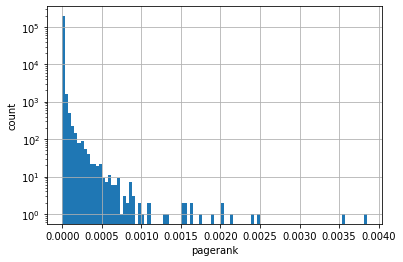

In [5]:
plot = comp_bio_result_df['pagerank'].hist(bins=100, log=True)
plot.set_xlabel('pagerank')
plot.set_ylabel('count')

In [6]:
comp_bio_result_df[comp_bio_result_df['pagerank'] > .001].sort_values(by='pagerank', ascending = False)

,doi,pagerank
1462,10.1038/35057062,0.003848
292,10.1126/science.1058040,0.003565
4014,10.1146/annurev.genom.9.081307.164359,0.002493
1179,10.1093/bioinformatics/btp352,0.002403
1829,10.1038/nature01511,0.002132
277,10.1101/gr.1239303,0.002035
275,10.1074/mcp.m200025-mcp200,0.002013
3303,10.1101/gr.8.3.175,0.001924
2107,10.1126/science.292.5518.929,0.001749
20026,10.1002/jms.290,0.001652


In [7]:
with open('../output/computational_biology-first_degree-pagerank.pkl', 'rb') as in_file:
    pagerank_results = pickle.load(in_file)

In [8]:
comp_bio_first_df = pd.DataFrame(reformat_results(pagerank_results, 'pagerank'))

In [9]:
comp_bio_first_df['pagerank'].value_counts()

9.831859e-08    2012524
1.018887e-07      28365
1.017400e-07      28001
1.019681e-07      27433
1.018128e-07      27370
                 ...   
1.138684e-07          1
1.243614e-07          1
1.373392e-07          1
1.643719e-07          1
1.001414e-07          1
Name: pagerank, Length: 787639, dtype: int64

Text(0, 0.5, 'count')

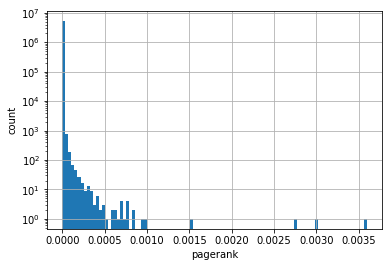

In [10]:
plot = comp_bio_first_df['pagerank'].hist(bins=100, log=True)
plot.set_xlabel('pagerank')
plot.set_ylabel('count')

In [11]:
comp_bio_first_df[comp_bio_first_df['pagerank'] > .0005].sort_values(by='pagerank', ascending = False)

,doi,pagerank
2251,10.1038/nmeth.2089,0.003592
2563,10.1038/nmeth.2019,0.002987
9265,10.1093/molbev/msr121,0.002749
16829,10.1093/bioinformatics/17.8.754,0.001528
3710,10.1186/s13059-014-0550-8,0.000995
90713,10.1093/nar/gkp848,0.000964
1600,10.1038/nprot.2008.211,0.000859
17344,10.1128/aem.01541-09,0.000832
16951,10.1093/bioinformatics/btp187,0.000785
5538,10.1093/bioinformatics/btu170,0.000776


### Results
PageRank seems to be running as expected, highly-ranked papers tend to be things I've heard of e.g. cytoscape and the original human genome paper.

Interestingly though very popular papers tend to be highly ranked regardless, the order isn't super stable between the network with and without out-of-heading citations. For example, the highest ranked papers using solely CB - CB citations are the two human genome sequence papers, while the top papers when including outside-of-CB citations are largely tools.

In [12]:
with open('../output/computational_biology-betweenness_centrality.pkl', 'rb') as in_file:
    results = pickle.load(in_file)

In [13]:
result_df = pd.DataFrame(reformat_results(results, 'betweenness'))

In [14]:
result_df['betweenness'].value_counts()

0.000000e+00    164014
5.089292e-08       969
1.017858e-07       567
1.526787e-07       336
2.544646e-08       283
                 ...  
1.384053e-05         1
7.987702e-06         1
6.974271e-07         1
2.324720e-05         1
1.387593e-06         1
Name: betweenness, Length: 24518, dtype: int64

Text(0, 0.5, 'count')

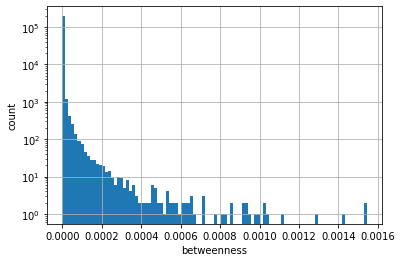

In [15]:
plot = result_df['betweenness'].hist(bins=100, log=True)
plot.set_xlabel('betweenness')
plot.set_ylabel('count')

In [16]:
result_df[result_df['betweenness'] > .001].sort_values(by='betweenness', ascending = False)

,doi,betweenness
5610,10.1111/imm.13012,0.001543
1782,10.1093/nar/gkx1158,0.001540
28345,10.1002/0471142727.mb0418s103,0.001431
58060,10.1016/j.envint.2019.05.066,0.001282
123884,10.18632/aging.203286,0.001116
8936,10.1016/j.cell.2015.09.053,0.001040
128366,10.3389/fimmu.2019.01302,0.001033
64469,10.1016/j.jprot.2017.03.016,0.001031


In [17]:
with open('../output/computational_biology-first_degree-betweenness_centrality.pkl', 'rb') as in_file:
    results = pickle.load(in_file)

In [18]:
result_df = pd.DataFrame(reformat_results(results, 'betweenness'))

In [19]:
result_df['betweenness'].value_counts()

0.000000e+00    5015115
1.932079e-09       1616
3.864158e-09        998
5.796237e-09        709
7.728316e-09        564
                 ...   
8.253747e-07          1
4.379669e-07          1
1.558732e-06          1
8.387273e-06          1
1.837085e-08          1
Name: betweenness, Length: 127483, dtype: int64

Text(0, 0.5, 'count')

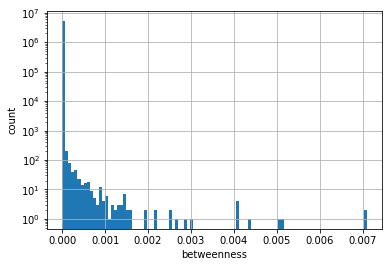

In [20]:
plot = result_df['betweenness'].hist(bins=100, log=True)
plot.set_xlabel('betweenness')
plot.set_ylabel('count')

In [21]:
result_df[result_df['betweenness'] > .001].sort_values(by='betweenness', ascending = False)

,doi,betweenness
79267,10.1002/prot.25415,0.007095
2727486,10.1002/prot.21813,0.007095
162824,10.1038/msb.2012.19,0.005129
58614,10.1016/j.sbi.2009.02.005,0.005051
328810,10.1002/prot.25423,0.004352
1801869,10.1146/annurev-arplant-042809-112242,0.004066
451203,10.1186/1471-2229-7-45,0.004066
202188,10.1007/978-1-4939-9173-0_1,0.004066
644123,10.1016/j.gene.2009.02.006,0.004066
97,10.1038/35057062,0.003013


### Results
This estimation of betweenness seems to have a lot of variance to it (unsurprising since it's only using 100 starting points). However, even with only 100 starting points, each network still takes a few minutes to run, and increasing the number of points should increase the runtime ~linearly. To use ~10% of the nodes to make an approximation would take hours per network at the least. As a result, the runtime complexity of calculating betweenness centrality may make it infeasible for this project

In [22]:
with open('../output/genetics-pagerank.pkl', 'rb') as in_file:
    results = pickle.load(in_file)
    
print(len(results))

208506


In [23]:
genetics_result_df = pd.DataFrame(reformat_results(results, 'pagerank'))

In [24]:
genetics_result_df['pagerank'].value_counts()

0.000002    55560
0.000002     1703
0.000002     1652
0.000003     1573
0.000002     1570
            ...  
0.000003        1
0.000002        1
0.000003        1
0.000006        1
0.000002        1
Name: pagerank, Length: 122300, dtype: int64

Text(0, 0.5, 'count')

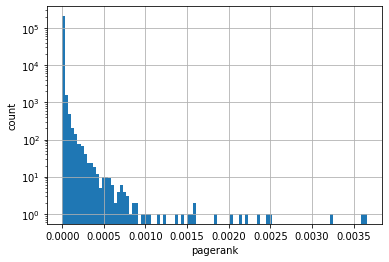

In [25]:
plot = genetics_result_df['pagerank'].hist(bins=100, log=True)
plot.set_xlabel('pagerank')
plot.set_ylabel('count')

In [26]:
genetics_result_df[genetics_result_df['pagerank'] > .001].sort_values(by='pagerank', ascending = False)

,doi,pagerank
662,10.1126/science.287.5461.2204,0.003657
282,10.1038/75556,0.003593
710,10.1038/35057062,0.003227
1211,10.1093/bioinformatics/btp352,0.002494
3596,10.1146/annurev.genom.9.081307.164359,0.002462
292,10.1074/mcp.m200025-mcp200,0.002344
307,10.1126/science.1058040,0.002201
1885,10.1038/nature01511,0.002156
2028,10.1038/227680a0,0.002045
2868,10.1101/gr.8.3.175,0.001848


In [27]:
with open('../output/genetics-first_degree-pagerank.pkl', 'rb') as in_file:
    results = pickle.load(in_file)

In [28]:
genetics_first_result_df = pd.DataFrame(reformat_results(results, 'pagerank'))

In [29]:
genetics_first_result_df['pagerank'].value_counts()

7.896116e-08    2585613
8.234711e-08      24461
8.242773e-08      24406
8.199441e-08      24145
8.205895e-08      23872
                 ...   
1.063167e-07          1
1.001408e-07          1
1.514377e-06          1
1.341458e-07          1
1.094364e-07          1
Name: pagerank, Length: 820178, dtype: int64

Text(0, 0.5, 'count')

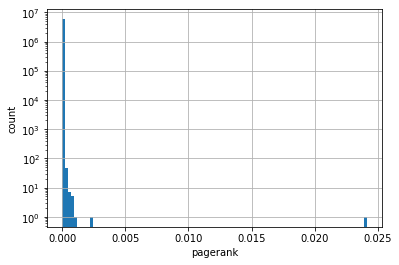

In [30]:
plot = genetics_first_result_df['pagerank'].hist(bins=100, log=True)
plot.set_xlabel('pagerank')
plot.set_ylabel('count')

In [31]:
genetics_first_result_df[genetics_first_result_df['pagerank'] > .001].sort_values(by='pagerank', ascending = False)

,doi,pagerank
1593,10.1038/227680a0,0.024112
8701,10.1093/molbev/msr121,0.002347
1481,10.1038/nprot.2008.211,0.001106


### Results

The distribution of papers in the first-degree results seems to imply there is something strange going on there. I have no idea what it is though (the outlier points are the paper that introduces a type of loading buffer that gets cited every time someone runs SDS-PAGE gels, the MEGA5 paper, and the DAVID paper).

In [32]:
with open('../output/artificial_intelligence-pagerank.pkl', 'rb') as in_file:
    results = pickle.load(in_file)
    
print(len(results))

102221


In [33]:
ai_result_df = pd.DataFrame(reformat_results(results, 'pagerank'))

In [34]:
ai_result_df['pagerank'].value_counts()

0.000003    32864
0.000006     1577
0.000005     1527
0.000004     1322
0.000004     1025
            ...  
0.000009        1
0.000008        1
0.000010        1
0.000008        1
0.000005        1
Name: pagerank, Length: 50621, dtype: int64

Text(0, 0.5, 'count')

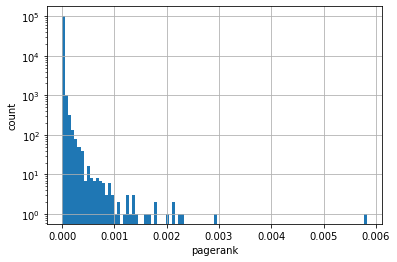

In [35]:
plot = ai_result_df['pagerank'].hist(bins=100, log=True)
plot.set_xlabel('pagerank')
plot.set_ylabel('count')

In [36]:
ai_result_df[ai_result_df['pagerank'] > .001].sort_values(by='pagerank', ascending = False)

,doi,pagerank
1426,10.1038/nature14539,0.005823
178,10.1162/neco.1997.9.8.1735,0.002971
3558,10.1101/gr.1239303,0.002328
16,10.1162/neco.2006.18.7.1527,0.002241
123,10.1038/355161a0,0.002154
160,10.1162/neco.1995.7.6.1129,0.002118
1515,10.1038/nature14236,0.002015
94,10.1126/science.7761831,0.001756
25608,10.1109/tip.2005.852470,0.001753
3590,10.1038/nature21056,0.001690


In [37]:
with open('../output/artificial_intelligence-first_degree-pagerank.pkl', 'rb') as in_file:
    results = pickle.load(in_file)

In [38]:
ai_first_result_df = pd.DataFrame(reformat_results(results, 'pagerank'))

In [39]:
ai_first_result_df['pagerank'].value_counts()

1.675458e-07    1385528
1.755445e-07      21802
1.760444e-07      21439
1.757868e-07      21236
1.753159e-07      21064
                 ...   
1.907697e-07          1
2.317938e-07          1
3.591909e-07          1
3.856918e-07          1
2.446885e-07          1
Name: pagerank, Length: 282814, dtype: int64

Text(0, 0.5, 'count')

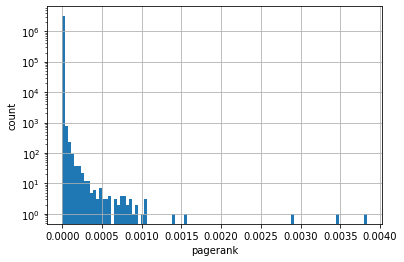

In [40]:
plot = ai_first_result_df['pagerank'].hist(bins=100, log=True)
plot.set_xlabel('pagerank')
plot.set_ylabel('count')

In [41]:
ai_first_result_df[ai_first_result_df['pagerank'] > .001].sort_values(by='pagerank', ascending = False)

,doi,pagerank
4812,10.1101/gr.1239303,0.003831
462,10.1162/neco.1997.9.8.1735,0.003465
5576,10.1038/nature14539,0.002880
2142,10.1073/pnas.122653799,0.001537
36455,10.1126/science.1070821,0.001394
387,10.1162/neco.2006.18.7.1527,0.001066
34616,10.1016/j.jmb.2004.05.028,0.001064
372,10.1162/neco.1995.7.6.1129,0.001050
34917,10.4278/0890-1171-12.1.38,0.001001


### Results
The in-term and first-hop results for AI seem more similar. I should probably plot the results though rather than just reading through the top few papers.

On an unrelated note, 10.1162/neco.1997.9.8.1735 is the original Schmidhuber LSTM paper which apparently is archived in pubmed somewhere

### Results
The correlation coefficients between pagerank values for the graph of solely citations between a MeSH heading and between at least paper with the MeSH heading and another paper are very low 

In [42]:
merged_df = comp_bio_result_df.merge(comp_bio_first_df, on='doi')
merged_df = merged_df.rename({'pagerank_x': 'only_comp_bio', 'pagerank_y': 'first_degree'}, axis='columns')
merged_df = merged_df.sort_values(by='only_comp_bio', ascending=False)
merged_df

,doi,only_comp_bio,first_degree
1462,10.1038/35057062,0.003848,6.910817e-04
292,10.1126/science.1058040,0.003565,4.069068e-04
4014,10.1146/annurev.genom.9.081307.164359,0.002493,4.241801e-05
1179,10.1093/bioinformatics/btp352,0.002403,7.563353e-04
1829,10.1038/nature01511,0.002132,1.167426e-04
...,...,...,...
145980,10.1016/j.cub.2005.10.043,0.000001,2.879874e-06
145982,10.1016/j.cub.2007.04.023,0.000001,4.979367e-07
21471,10.1093/bib/bbab122,0.000001,1.530608e-07
145986,10.1016/j.cub.2014.02.049,0.000001,9.512734e-06


In [43]:
top_df = merged_df[:1000]
top_df

,doi,only_comp_bio,first_degree
1462,10.1038/35057062,0.003848,0.000691
292,10.1126/science.1058040,0.003565,0.000407
4014,10.1146/annurev.genom.9.081307.164359,0.002493,0.000042
1179,10.1093/bioinformatics/btp352,0.002403,0.000756
1829,10.1038/nature01511,0.002132,0.000117
...,...,...,...
21884,10.1016/j.ymben.2003.09.002,0.000099,0.000011
18490,10.1038/nature08670,0.000099,0.000107
13963,10.1016/j.molcel.2006.06.026,0.000099,0.000049
37729,10.1186/1471-2105-3-18,0.000098,0.000004


In [44]:
fig = px.scatter(top_df, x='only_comp_bio', y='first_degree', log_x=True, log_y=True, trendline='ols', hover_data=['doi'])
fig.show()

In [45]:
merged_df = ai_result_df.merge(ai_first_result_df, on='doi')
merged_df = merged_df.rename({'pagerank_x': 'only_ai', 'pagerank_y': 'first_degree'}, axis='columns')
merged_df = merged_df.sort_values(by='only_ai', ascending=False)
top_df = merged_df[:1000]
merged_df

,doi,only_ai,first_degree
1426,10.1038/nature14539,0.005823,2.879861e-03
178,10.1162/neco.1997.9.8.1735,0.002971,3.464975e-03
3558,10.1101/gr.1239303,0.002328,3.830693e-03
16,10.1162/neco.2006.18.7.1527,0.002241,1.065662e-03
123,10.1038/355161a0,0.002154,2.411891e-05
...,...,...,...
60126,10.1186/s12984-021-00972-7,0.000003,1.675458e-07
60127,10.1155/2021/6894001,0.000003,1.675458e-07
60129,10.1021/acs.analchem.1c04000,0.000003,1.675458e-07
60130,10.1016/j.prevetmed.2021.105565,0.000003,1.675458e-07


In [46]:
fig = px.scatter(top_df, x='only_ai', y='first_degree', log_x=True, log_y=True, trendline='ols', hover_data=['doi'])
fig.show()

In [47]:
merged_df = genetics_result_df.merge(genetics_first_result_df, on='doi')
merged_df = merged_df.rename({'pagerank_x': 'only_genetics', 'pagerank_y': 'first_degree'}, axis='columns')
merged_df = merged_df.sort_values(by='only_genetics', ascending=False)
top_df = merged_df[:1000]
top_df

,doi,only_genetics,first_degree
662,10.1126/science.287.5461.2204,0.003657,0.000082
282,10.1038/75556,0.003593,0.000884
710,10.1038/35057062,0.003227,0.000637
1211,10.1093/bioinformatics/btp352,0.002494,0.000758
3596,10.1146/annurev.genom.9.081307.164359,0.002462,0.000035
...,...,...,...
70743,10.1086/392950,0.000085,0.000022
86866,10.1101/sqb.1986.051.01.007,0.000085,0.000005
2933,10.1016/j.cell.2012.04.027,0.000085,0.000022
35906,10.1016/s0140-6736(03)12715-8,0.000085,0.000040


In [48]:
fig = px.scatter(top_df, x='only_genetics', y='first_degree', log_x=True, log_y=True, trendline='ols', hover_data=['doi'])
fig.show()

## Paired papers between MeSH terms
There doesn't seem to be a lot of correlation between the pagerank of papers within a field when comparing the field only and one-hop papers. Let's see what the between-field correlation looks like

In [49]:
merged_df = genetics_result_df.merge(ai_result_df, on='doi')
merged_df = merged_df.rename({'pagerank_x': 'genetics', 'pagerank_y': 'ai'}, axis='columns')

In [50]:
fig = px.scatter(merged_df, x='genetics', y='ai', log_x=True, log_y=True, trendline='ols', hover_data=['doi'], opacity=.3,
                title='Genetics - Artificial Intelligence PageRank Correlation')
fig.show()

In [51]:
merged_df = genetics_result_df.merge(comp_bio_result_df, on='doi')
merged_df = merged_df.rename({'pagerank_x': 'genetics', 'pagerank_y': 'comp_bio'}, axis='columns')
merged_df

,doi,genetics,comp_bio
0,10.1016/j.neubiorev.2013.03.020,0.000002,0.000002
1,10.1038/nrg3243,0.000009,0.000009
2,10.1016/j.neubiorev.2016.06.015,0.000002,0.000001
3,10.1016/j.neubiorev.2016.08.021,0.000003,0.000003
4,10.1016/j.neubiorev.2016.10.031,0.000002,0.000002
...,...,...,...
112003,10.7150/thno.61832,0.000002,0.000002
112004,10.1152/ajprenal.00409.2021,0.000002,0.000001
112005,10.1371/journal.pone.0202779,0.000002,0.000002
112006,10.1093/ptj/pzab243,0.000002,0.000002


In [52]:
fig = px.scatter(merged_df, x='genetics', y='comp_bio', log_x=True, log_y=True, trendline='ols', hover_data=['doi'], opacity=.1,
                 title='Genetics - Computational Biology PageRank Correlation')
fig.show()

In [53]:
merged_df = comp_bio_result_df.merge(ai_result_df, on='doi')
merged_df = merged_df.rename({'pagerank_x': 'comp_bio', 'pagerank_y': 'ai'}, axis='columns')

In [54]:
fig = px.scatter(merged_df, x='comp_bio', y='ai', log_x=True, log_y=True, trendline='ols', hover_data=['doi'],
                 title='Computational Biology - Artificial Intelligence PageRank Correlation', opacity=.2)
fig.show()

### Results
There is far more of a correlation between comp bio and AI and especially genetics and comp bio than between comp genetics and AI. It is unclear whether this is due to different amounts of overlap in the graphs though.

Anecdotally, the outlier points seem to make sense, e.g. a [paper](https://bmcbioinformatics.biomedcentral.com/articles/10.1186/1471-2105-6-31) on heuristics for biological sequence comparison is more important in comp bio than ai, where a [perspective piece](https://www.nejm.org/doi/10.1056/nejmp1606181) on how big data and machine learning with transform clinical medicine was more valued by AI

The big question is on how to test this more rigorously. How do we generate a null distribution to test against? Maybe based on an equivalently sized set of overlapping papers, select that many papers from the each original network, then add papers at random from the first-degree neighbors? Or randomize edges?

## Disruption index

In [55]:
with open('../output/computational_biology-disruption_idx.pkl', 'rb') as in_file:
    disruption_idx_results = pickle.load(in_file)

In [56]:
comp_bio_result_df = pd.DataFrame(reformat_results(disruption_idx_results, 'disruption_idx'))

Text(0, 0.5, 'count')

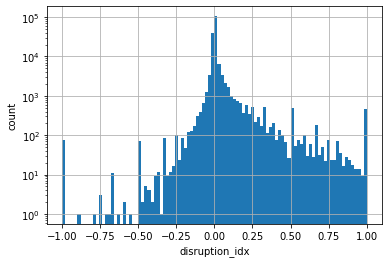

In [57]:
plot = comp_bio_result_df['disruption_idx'].hist(bins=100, log=True)
plot.set_xlabel('disruption_idx')
plot.set_ylabel('count')

In [58]:
comp_bio_result_df[comp_bio_result_df['disruption_idx'] > .001].sort_values(by='disruption_idx', ascending = False)

,doi,disruption_idx
114140,10.1002/mgg3.392,1.000000
25181,10.1021/acs.analchem.9b03616,1.000000
51631,10.1016/j.ibmb.2008.05.005,1.000000
84230,10.1021/bi0300332,1.000000
84158,10.1002/jat.3302,1.000000
...,...,...
99298,10.1038/s41598-018-19614-5,0.001001
57514,10.1111/nph.14461,0.001001
18824,10.1093/bioinformatics/btm581,0.001001
1092,10.1016/j.pbi.2018.11.001,0.001001


In [59]:
with open('../output/computational_biology-first_degree-disruption_idx.pkl', 'rb') as in_file:
    disruption_idx_results = pickle.load(in_file)

In [60]:
comp_bio_first_df = pd.DataFrame(reformat_results(disruption_idx_results, 'disruption_idx'))

In [61]:
comp_bio_first_df['disruption_idx'].value_counts()

 0.000000    2068142
 0.058824       1695
 0.043478       1608
 0.050000       1605
 0.052632       1604
              ...   
 0.029426          1
-0.000147          1
-0.000267          1
 0.000609          1
 0.000023          1
Name: disruption_idx, Length: 205758, dtype: int64

Text(0, 0.5, 'count')

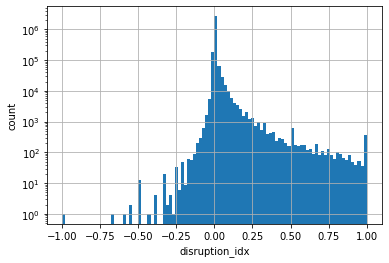

In [62]:
plot = comp_bio_first_df['disruption_idx'].hist(bins=100, log=True)
plot.set_xlabel('disruption_idx')
plot.set_ylabel('count')

In [63]:
comp_bio_first_df.sort_values(by='disruption_idx', ascending = False)

,doi,disruption_idx
101211,10.2165/00007256-200535100-00001,1.000000
2633959,10.1016/j.aanat.2015.01.007,1.000000
423750,10.1038/nbt.3918,1.000000
1201830,10.1111/tan.14061,1.000000
685840,10.1126/science.1197074,1.000000
...,...,...
1629412,10.1186/1471-2105-13-s18-a1,-0.555556
1136883,10.1186/1471-2105-11-s10-i1,-0.555556
2497884,10.1101/pdb.prot094649,-0.600000
1859231,10.1093/bioinformatics/btn487,-0.666667


In [64]:
with open('../output/genetics-disruption_idx.pkl', 'rb') as in_file:
    results = pickle.load(in_file)
    
print(len(results))

208506


In [65]:
genetics_result_df = pd.DataFrame(reformat_results(results, 'disruption_idx'))

In [66]:
genetics_result_df['disruption_idx'].value_counts()

 0.000000    65261
 0.500000      889
 1.000000      821
 0.333333      778
 0.250000      625
             ...  
 0.000714        1
-0.016551        1
 0.005003        1
 0.059850        1
 0.000183        1
Name: disruption_idx, Length: 33942, dtype: int64

Text(0, 0.5, 'count')

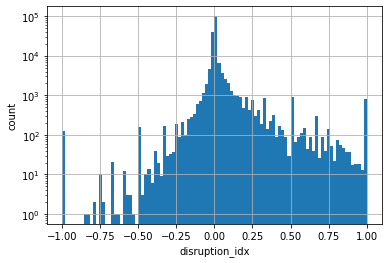

In [67]:
plot = genetics_result_df['disruption_idx'].hist(bins=100, log=True)
plot.set_xlabel('disruption_idx')
plot.set_ylabel('count')

In [68]:
genetics_result_df.sort_values(by='disruption_idx', ascending = False)

,doi,disruption_idx
16909,10.1073/pnas.2020020118,1.0
117530,10.1111/j.1423-0410.2010.01462.x,1.0
167092,10.1086/301696,1.0
53381,10.1007/s12033-015-9906-x,1.0
7601,10.4049/jimmunol.179.12.8525,1.0
...,...,...
136044,10.1371/journal.pone.0103185,-1.0
118683,10.1186/1742-4682-4-45,-1.0
77002,10.1101/pdb.prot072793,-1.0
142246,10.1016/0046-8177(92)90295-e,-1.0


In [69]:
with open('../output/genetics-first_degree-disruption_idx.pkl', 'rb') as in_file:
    results = pickle.load(in_file)

In [70]:
genetics_first_result_df = pd.DataFrame(reformat_results(results, 'disruption_idx'))

In [71]:
genetics_first_result_df['disruption_idx'].value_counts()

 0.000000    2646498
 0.000006      18713
 0.000011       5580
 0.000017       2291
 0.047619       2048
              ...   
 0.000060          1
 0.002830          1
 0.023138          1
 0.000575          1
-0.000102          1
Name: disruption_idx, Length: 199042, dtype: int64

Text(0, 0.5, 'count')

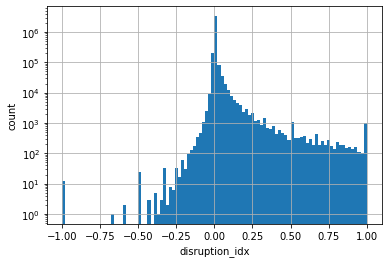

In [72]:
plot = genetics_first_result_df['disruption_idx'].hist(bins=100, log=True)
plot.set_xlabel('disruption_idx')
plot.set_ylabel('count')

In [73]:
genetics_first_result_df.sort_values(by='disruption_idx', ascending = False)

,doi,disruption_idx
56151,10.1126/science.1070371,1.0
2353012,10.1016/s0140-6736(65)91197-9,1.0
2731281,10.1155/2016/1574971,1.0
2353633,10.1007/bf02154088,1.0
2354340,10.1007/bf01073203,1.0
...,...,...
676867,10.1016/0010-4825(93)90020-2,-1.0
2177223,10.1007/bf02157970,-1.0
1432574,10.1002/cld.1009,-1.0
1320957,10.1111/j.1755-3768.1965.tb00334.x,-1.0


In [74]:
with open('../output/artificial_intelligence-disruption_idx.pkl', 'rb') as in_file:
    results = pickle.load(in_file)
    
print(len(results))

102221


In [75]:
ai_result_df = pd.DataFrame(reformat_results(results, 'disruption_idx'))

In [76]:
ai_result_df['disruption_idx'].value_counts()

0.000000    35965
1.000000      701
0.500000      650
0.333333      558
0.250000      480
            ...  
0.045113        1
0.020588        1
0.638889        1
0.003063        1
0.000675        1
Name: disruption_idx, Length: 11372, dtype: int64

Text(0, 0.5, 'count')

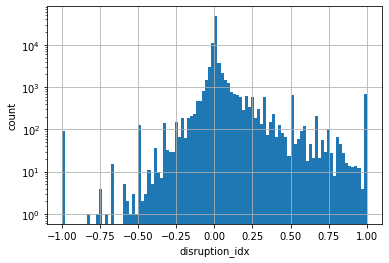

In [77]:
plot = ai_result_df['disruption_idx'].hist(bins=100, log=True)
plot.set_xlabel('disruption_idx')
plot.set_ylabel('count')

In [78]:
ai_result_df.sort_values(by='disruption_idx', ascending = False)

,doi,disruption_idx
7498,10.1186/s40168-018-0398-3,1.0
42567,10.1016/j.media.2008.12.002,1.0
42628,10.3233/wor-162473,1.0
42629,10.3233/wor-162474,1.0
42941,10.1093/bioinformatics/bts354,1.0
...,...,...
74008,10.1111/iwj.13603,-1.0
31463,10.3390/s21227467,-1.0
70616,10.1109/tnn.2010.2044803,-1.0
76002,10.1162/evco.2007.15.2.223,-1.0


In [79]:
with open('../output/artificial_intelligence-first_degree-disruption_idx.pkl', 'rb') as in_file:
    results = pickle.load(in_file)

In [80]:
ai_first_result_df = pd.DataFrame(reformat_results(results, 'disruption_idx'))

In [81]:
ai_first_result_df['disruption_idx'].value_counts()

 0.000000    1402728
 0.000047        901
 0.090909        898
 0.047619        875
 0.062500        867
              ...   
 0.000072          1
 0.000201          1
-0.003940          1
-0.000473          1
 0.000107          1
Name: disruption_idx, Length: 71945, dtype: int64

Text(0, 0.5, 'count')

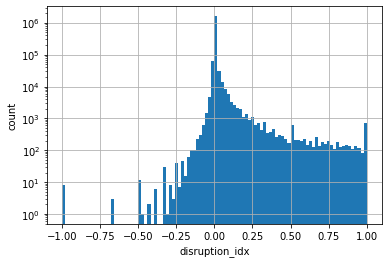

In [82]:
plot = ai_first_result_df['disruption_idx'].hist(bins=100, log=True)
plot.set_xlabel('disruption_idx')
plot.set_ylabel('count')

### Results
The distributions of disruption indices are fairly right-heavy, which makes sense; to have a negative value, lots of the papers citing a paper must also cite the papers it cites.

Also, likely because the metric largely doesn't care about the number of citations an article gets, the papers with high disruption indices aren't necessarily well known in their fields.

In [83]:
ai_first_result_df.sort_values(by='disruption_idx', ascending = False)

,doi,disruption_idx
443051,10.1590/s0074-02762000000500012,1.0
279886,10.1002/bmc.1130060613,1.0
497489,10.1089/lap.2008.0256,1.0
1115455,10.1109/tnn.2005.853422,1.0
591643,10.3390/s21072315,1.0
...,...,...
288086,10.1016/0094-5765(92)90192-l,-1.0
1310478,10.1001/jamaophthalmol.2021.1551,-1.0
785749,10.1109/iembs.1990.692009,-1.0
187342,10.1155/2016/5206268,-1.0


In [84]:
merged_df = comp_bio_result_df.merge(comp_bio_first_df, on='doi')
merged_df = merged_df.rename({'disruption_idx_x': 'only_comp_bio', 'disruption_idx_y': 'first_degree'}, axis='columns')
merged_df = merged_df.sort_values(by='only_comp_bio', ascending=False)
merged_df

,doi,only_comp_bio,first_degree
87589,10.1046/j.1365-2958.2003.03499.x,1.0,0.161479
50537,10.1142/s0219720013410047,1.0,0.027778
13203,10.1016/j.lfs.2021.119525,1.0,0.002024
4741,10.1371/journal.pcbi.1002153,1.0,0.044776
131324,10.1124/dmd.118.081083,1.0,0.084507
...,...,...,...
135870,10.1186/s12958-019-0486-7,-1.0,0.074074
169585,10.1371/journal.pcbi.1004682,-1.0,0.166667
170908,10.1007/s11120-012-9779-9,-1.0,-0.001485
154854,10.1371/journal.pcbi.1005745,-1.0,0.078431


In [ ]:
fig = px.scatter(merged_df, x='only_comp_bio', y='first_degree', trendline='ols', opacity=.2)
fig.show()

In [ ]:
merged_df = ai_result_df.merge(ai_first_result_df, on='doi')
merged_df = merged_df.rename({'disruption_idx_x': 'only_ai', 'disruption_idx_y': 'first_degree'}, axis='columns')
merged_df = merged_df.sort_values(by='only_ai', ascending=False)
merged_df

In [ ]:
fig = px.scatter(merged_df, x='only_ai', y='first_degree', trendline='ols', opacity=.2)
fig.show()

In [ ]:
merged_df = genetics_result_df.merge(genetics_first_result_df, on='doi')
merged_df = merged_df.rename({'disruption_idx_x': 'only_genetics', 'disruption_idx_y': 'first_degree'}, axis='columns')
merged_df = merged_df.sort_values(by='only_genetics', ascending=False)

In [ ]:
fig = px.scatter(merged_df, x='only_genetics', y='first_degree', trendline='ols', opacity=.2)
fig.show()

## Paired papers between MeSH terms
There doesn't seem to be a lot of correlation between the disruption_idx of papers within a field when comparing the field only and one-hop papers. Let's see what the between-field correlation looks like

In [ ]:
merged_df = genetics_first_result_df.merge(ai_first_result_df, on='doi')
merged_df = merged_df.rename({'disruption_idx_x': 'genetics', 'disruption_idx_y': 'ai'}, axis='columns')

In [ ]:
fig = px.scatter(merged_df, x='genetics', y='ai',trendline='ols', hover_data=['doi'], opacity=.3,
                title='Genetics - Artificial Intelligence Disruption Index Correlation')
fig.show()

In [ ]:
merged_df = genetics_first_result_df.merge(comp_bio_first_df, on='doi')
merged_df = merged_df.rename({'disruption_idx_x': 'genetics', 'disruption_idx_y': 'comp_bio'}, axis='columns')
merged_df

In [ ]:
fig = px.scatter(merged_df, x='genetics', y='comp_bio', trendline='ols', hover_data=['doi'], opacity=.1,
                 title='Genetics - Computational Biology Disruption Index Correlation')
fig.show()

In [ ]:
merged_df = comp_bio_first_df.merge(ai_first_result_df, on='doi')
merged_df = merged_df.rename({'disruption_idx_x': 'comp_bio', 'disruption_idx_y': 'ai'}, axis='columns')

In [ ]:
fig = px.scatter(merged_df, x='comp_bio', y='ai', trendline='ols', hover_data=['doi'],
                 title='Computational Biology - Artificial Intelligence Disruption Index Correlation', opacity=.2)
fig.show()

### Results
There is some correlation between fields and their first-degree expansions, as well as between fields. The relationship does look much weaker than between fields in pagerank. Maybe a relative stability analysis would be interesting.